<a href="https://colab.research.google.com/github/MChaudhry9/Bootcamp-Web-development-Data-Science/blob/main/Mamuna_Chaudhry_Day_2_Visualization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import requests as re
import seaborn as sns
from tqdm.auto import tqdm
import matplotlib.pyplot as plt


import plotly
import plotly.offline as py
import plotly.graph_objs as go
import plotly.express as px

# Retrieve Data

In [ ]:
ROOT = "https://data.cityofnewyork.us/resource/h9gi-nx95.json" 
LIMIT = 1000000
YEAR = 2022
URL = f"{ROOT}?$limit={LIMIT}&$where=crash_date between '{YEAR}-01-01T00:00:00' and '{YEAR}-12-31T00:00:00'"

response = re.get(URL)
#response.text


df = pd.read_json(response.text)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103823 entries, 0 to 103822
Data columns (total 29 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   crash_date                     103823 non-null  object        
 1   crash_time                     103823 non-null  datetime64[ns]
 2   latitude                       94884 non-null   float64       
 3   longitude                      94884 non-null   float64       
 4   location                       94884 non-null   object        
 5   on_street_name                 75540 non-null   object        
 6   number_of_persons_injured      103823 non-null  int64         
 7   number_of_persons_killed       103823 non-null  int64         
 8   number_of_pedestrians_injured  103823 non-null  int64         
 9   number_of_pedestrians_killed   103823 non-null  int64         
 10  number_of_cyclist_injured      103823 non-null  int64         
 11  

In [ ]:
df.describe()

,latitude,longitude,number_of_persons_injured,number_of_persons_killed,number_of_pedestrians_injured,number_of_pedestrians_killed,number_of_cyclist_injured,number_of_cyclist_killed,number_of_motorist_injured,number_of_motorist_killed,collision_id,zip_code
count,94884.000000,94884.000000,103823.000000,103823.000000,103823.000000,103823.000000,103823.000000,103823.000000,103823.000000,103823.000000,1.038230e+05,68736.000000
mean,39.924361,-72.464741,0.499966,0.002755,0.086387,0.001271,0.048409,0.000183,0.342140,0.001108,4.543819e+06,10881.100617
std,5.653773,10.261173,0.809442,0.054574,0.295246,0.035903,0.218676,0.013527,0.780748,0.036309,3.011176e+04,528.711256
min,0.000000,-74.254960,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.491064e+06,10000.000000
25%,40.664608,-73.963430,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.517806e+06,10456.000000
50%,40.713617,-73.919980,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.543803e+06,11208.000000
75%,40.780150,-73.864645,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.569774e+06,11237.000000
max,40.912167,0.000000,40.000000,3.000000,5.000000,2.000000,3.000000,1.000000,40.000000,3.000000,4.634781e+06,11697.000000


# Data Cleaning


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103823 entries, 0 to 103822
Data columns (total 29 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   crash_date                     103823 non-null  object        
 1   crash_time                     103823 non-null  datetime64[ns]
 2   latitude                       94884 non-null   float64       
 3   longitude                      94884 non-null   float64       
 4   location                       94884 non-null   object        
 5   on_street_name                 75540 non-null   object        
 6   number_of_persons_injured      103823 non-null  int64         
 7   number_of_persons_killed       103823 non-null  int64         
 8   number_of_pedestrians_injured  103823 non-null  int64         
 9   number_of_pedestrians_killed   103823 non-null  int64         
 10  number_of_cyclist_injured      103823 non-null  int64         
 11  

In [ ]:
#remove the missing values
df=df.dropna(subset=['latitude', "longitude"], how="any")

In [ ]:
#convert crash date to datetime
df["crash_date"]= pd.to_datetime(df["crash_date"])
df["crash_date_month"]=df["crash_date"].dt.month
df["crash_time_hour"]=df["crash_date"].dt.hour

#display
df.head()

,crash_date,crash_time,latitude,longitude,location,on_street_name,number_of_persons_injured,number_of_persons_killed,number_of_pedestrians_injured,number_of_pedestrians_killed,...,zip_code,cross_street_name,contributing_factor_vehicle_3,vehicle_type_code_3,contributing_factor_vehicle_4,contributing_factor_vehicle_5,vehicle_type_code_4,vehicle_type_code_5,crash_date_month,crash_time_hour
0,2022-01-01,2023-06-05 07:33:00,40.771477,-73.91824,"{'latitude': '40.771477', 'longitude': '-73.91...",HOYT AVENUE NORTH,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0
3,2022-01-01,2023-06-05 05:17:00,40.746930,-73.84866,"{'latitude': '40.74693', 'longitude': '-73.848...",GRAND CENTRAL PKWY,1,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0
4,2022-01-01,2023-06-05 01:30:00,40.819157,-73.96038,"{'latitude': '40.819157', 'longitude': '-73.96...",HENRY HUDSON PARKWAY,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0
5,2022-01-01,2023-06-05 16:40:00,40.806107,-73.91799,"{'latitude': '40.806107', 'longitude': '-73.91...",NaN,0,0,0,0,...,10454.0,520 EAST 137 STREET,NaN,NaN,NaN,NaN,NaN,NaN,1,0
6,2022-01-01,2023-06-05 13:07:00,40.742737,-73.87643,"{'latitude': '40.742737', 'longitude': '-73.87...",NaN,0,0,0,0,...,11373.0,89-22 43 AVENUE,Unspecified,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN,NaN,1,0


## Pandas Plot

* `bar` or `barh` for bar plots.
* `hist` for histogram.
* `box` for boxplot.
* `kde` or `density` for density plots.
* `area` for area plots.
* `scatter` for scatter plots.
* `hexbin` for hexagonal bin plots.
* `pie` for pie plots.

<Axes: ylabel='Frequency'>

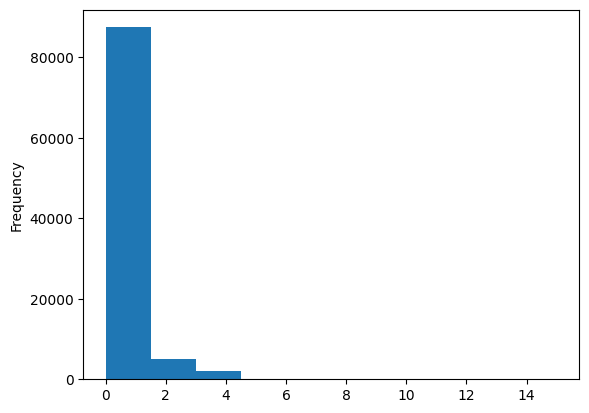

In [ ]:
df["number_of_persons_injured"].plot.hist()

In [ ]:
px.histogram(df, x="number_of_persons_injured")

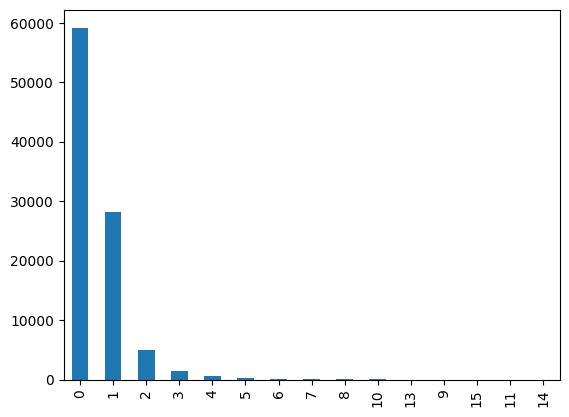

In [ ]:
temp=df["number_of_persons_injured"].value_counts().plot.bar()

# Finding 1: Date, Time, Death & Injury

1. What is the trend of motor vehicle collisions over time?

2. Are there more collisions in certain boroughs?

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 94884 entries, 0 to 103822
Data columns (total 31 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   crash_date                     94884 non-null  datetime64[ns]
 1   crash_time                     94884 non-null  datetime64[ns]
 2   latitude                       94884 non-null  float64       
 3   longitude                      94884 non-null  float64       
 4   location                       94884 non-null  object        
 5   on_street_name                 67752 non-null  object        
 6   number_of_persons_injured      94884 non-null  int64         
 7   number_of_persons_killed       94884 non-null  int64         
 8   number_of_pedestrians_injured  94884 non-null  int64         
 9   number_of_pedestrians_killed   94884 non-null  int64         
 10  number_of_cyclist_injured      94884 non-null  int64         
 11  number_of_cycl

In [ ]:
#line chart
groupby_df=df.groupby("crash_date_month",as_index=False)["number_of_persons_injured"].sum()
fig=px.line(groupby_df,x="crash_date_month" , 
        y="number_of_persons_injured",
        title="The number of people injured over months"
        )
for trace in fig.data:
  trace.mode="markers+lines"

fig.update_xaxes(title_text="Month")
fig.update_yaxes(title_text="# of people killed")
fig.write_html("./test.html")#to show 1 graph in html
fig.show()

In [ ]:
#bar chart
groupby_df=df.groupby("crash_date_month",as_index=False)["number_of_persons_killed"].sum()
px.bar(groupby_df,x="crash_date_month" , 
        y="number_of_persons_killed" ,
        #orientation="h", #this is to make the bar chart horizontal(change the y and x to match the horizontal graph)
        title="The number of people killed over months",
        text="crash_date_month" #to show the numbers in each separate bar
      )
#for trace in fig.data:
  #trace.mode="markers+lines"

#fig.update_xaxes(title_text="Month")
#fig.update_yaxes(title_text="# of people killed")
#fig.write_html("./test.html")#to show 1 graph in html
#fig.show()

# Finding 2: Date, Time & Crash Numbers

In [ ]:
#bar graph for crashs happening every month by borough
groupby_df=df.groupby( ["crash_date_month","borough"], as_index=False)["collision_id"].count()
px.bar(groupby_df, x="crash_date_month", y="collision_id", color="borough" ,text="collision_id" ,barmode="group") #barmode connects each month together

In [ ]:
groupy_df = df.groupby(["crash_time_hour", "borough"], 
                       as_index=False)["collision_id"].count()
px.bar(groupy_df, 
       x="crash_time_hour", 
       y="collision_id",
       color="borough",
       text="collision_id",
       title="Crash Count by Hour"
       )  

In [ ]:
#bar graph for crashs happening every hour
groupby_df=df.groupby( ["crash_time_hour","borough"], as_index=False)["collision_id"].count()
px.bar(groupby_df, x="crash_time_hour", y="collision_id", color="borough" ,text="collision_id" ,barmode="group") #barmode connects each month together


# Finding 3: Contributing Factors & Vehicle Type

## 3.1 Contributing Factor

What are the most common contributing factors to collisions?

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 94884 entries, 0 to 103822
Data columns (total 31 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   crash_date                     94884 non-null  datetime64[ns]
 1   crash_time                     94884 non-null  datetime64[ns]
 2   latitude                       94884 non-null  float64       
 3   longitude                      94884 non-null  float64       
 4   location                       94884 non-null  object        
 5   on_street_name                 67752 non-null  object        
 6   number_of_persons_injured      94884 non-null  int64         
 7   number_of_persons_killed       94884 non-null  int64         
 8   number_of_pedestrians_injured  94884 non-null  int64         
 9   number_of_pedestrians_killed   94884 non-null  int64         
 10  number_of_cyclist_injured      94884 non-null  int64         
 11  number_of_cycl

In [ ]:
#df["contributing_factor_vehicle_1"].value_counts()
contributing_factors=pd.concat([
                                df ["contributing_factor_vehicle_1"],
                                df ["contributing_factor_vehicle_2"],
                                df ["contributing_factor_vehicle_3"],
                                df ["contributing_factor_vehicle_4"],
                                df ["contributing_factor_vehicle_5"],
                                ])
contributing_factors=  contributing_factors.value_counts().reset_index() 
contributing_factors=  contributing_factors[contributing_factors['index'] != 'Unspecified'
                                           ]
contributing_factors.columns=["factors that lead to collisions", "count"]

px.bar(contributing_factors.head(10), x="factors that lead to collisions",y="count",text="count")

## 3.2 Vehicle Type

Are certain types of vehicles more likely to be involved in collisions?

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 94884 entries, 0 to 103822
Data columns (total 31 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   crash_date                     94884 non-null  datetime64[ns]
 1   crash_time                     94884 non-null  datetime64[ns]
 2   latitude                       94884 non-null  float64       
 3   longitude                      94884 non-null  float64       
 4   location                       94884 non-null  object        
 5   on_street_name                 67752 non-null  object        
 6   number_of_persons_injured      94884 non-null  int64         
 7   number_of_persons_killed       94884 non-null  int64         
 8   number_of_pedestrians_injured  94884 non-null  int64         
 9   number_of_pedestrians_killed   94884 non-null  int64         
 10  number_of_cyclist_injured      94884 non-null  int64         
 11  number_of_cycl

In [ ]:
contributing_factors=pd.concat([
                                df ["vehicle_type_code1"],
                                df ["vehicle_type_code2"],
                                df ["vehicle_type_code_3"],   
                                df ["vehicle_type_code_4"],
                                df ["vehicle_type_code_5"],
                                ])
contributing_factors=  contributing_factors.value_counts().reset_index() 
contributing_factors.columns=["vehicle type", "count"]

px.bar(contributing_factors.head(10), x="vehicle type",y="count",text="count")

# Finding 4: Mapping Collision Hotspots

In [ ]:
# Creating a DataFrame with the sum of injuries and fatalities
df['TOTAL INJURIES AND FATALITIES'] = df['number_of_persons_injured'] + df['number_of_persons_killed']

# Plot the heatmap using the filtered DataFrame with the center set to New York City
fig = px.density_mapbox(df,
                        lat='latitude',
                        lon='longitude',
                        z='TOTAL INJURIES AND FATALITIES',
                        radius=10,
                        hover_name='location',
                        hover_data=['crash_date', 'crash_time', 'borough'],
                        mapbox_style='carto-positron',
                        zoom=9,
                        center={'lat': 40.7128, 'lon': -74.0060},  # Coordinates for New York City
                        color_continuous_scale=px.colors.sequential.Viridis,
                        title='Collision Hotspots by Injuries and Fatalities (Heatmap)')

# Change the height of the map
fig.update_layout(height=1000)

fig.show()